## Laboratorium 7


## Detekcja obiektów za pomocą Faster-RCNN

### Wprowadzenie

Celem tej listy jest praktyczne zapoznanie się z działaniem dwuetapowych modeli do detekcji obiektów na przykładzie Faster R-CNN. Skorzystamy z gotowej implementacji modelu z pakietu [`torchvision`](https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py). Jeżeli masz inny ulubiony model działający na podobnej zasadzie, możesz z niego skorzystać zamiast podanego. Podobnie implementacja - jeśli masz swoją ulubioną bibliotekę np. Detectron2, MMDetection, możesz z niej skorzystać.

W zadaniu wykorzystany zostanie zbiór danych [_Chess Pieces Dataset_](https://public.roboflow.com/object-detection/chess-full) (autorstwa Roboflow, domena publiczna), ZIP z obrazami i anotacjami powinien być dołączony do instrukcji.

Podczas realizacji tej listy większy nacisk położony zostanie na inferencję z użyciem Faster R-CNN niż na uczenie (które przeprowadzisz raz\*). Kluczowe komponenty w tej architekturze (RPN i RoIHeads) można konfigurować bez ponownego uczenia, dlatego badania skupią się na ich strojeniu. Aby zrozumieć działanie modelu, konieczne będzie spojrzenie w jego głąb, włącznie z częściowym wykonaniem. W tym celu warto mieć na podorędziu kod źródłowy, w szczególności implementacje następujących klas (uwaga - linki do najnowszej implementacji; upewnij się więc, że czytasz kod używanej przez siebie wersji biblioteki):
* `FasterRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py
* `GeneralizedRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/generalized_rcnn.py
* `RegionProposalNetwork`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/rpn.py
* `RoIHeads`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/roi_heads.py

Dogłębne zrozumienie procedury uczenia modelu nie będzie wymagane, niemniej należy mieć ogólną świadomość jak ten proces przebiega i jakie funkcje kosztu są wykorzystywane. Użyjemy gotowej implementacji z submodułu [`references.detection`](https://github.com/pytorch/vision/blob/main/references/detection/train.py) w nieco uproszczonej wersji. Ponieważ ten moduł **nie** jest domyślnie instalowaną częścią pakietu `torchvision`, do instrukcji dołączono jego kod w nieznacznie zmodyfikowanej wersji (`references_detection.zip`).
Jeśli ciekawią Cię szczegóły procesu uczenia, zachęcam do lektury [artykułu](https://arxiv.org/abs/1506.01497) i analizy kodu implementacji.

In [1]:
#!pip install pycocotools

### Zadanie 0: Uczenie

Krokiem "zerowym" będzie przygotowanie wstępnie nauczonego modelu i douczenie go na docelowym zbiorze.
Podany zestaw hiperparametrów powinien dawać przyzwoite (niekoniecznie idealne) wyniki - jeśli chcesz, śmiało dobierz swoje własne; nie spędzaj na tym jednak zbyt wiele czasu.

Twoim zadaniem jest nie tylko przeklikanie poniższych komórek, ale przynajmniej ogólne zrozumienie procesu uczenia (przejrzyj implementację `train_one_epoch`) i struktury modelu.

In [119]:
import os
import time
import datetime

import torch
import torch.utils.data
import torchvision
import torchvision.models.detection as M
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image
from torchvision.transforms import functional as F
from torchvision import transforms as T

from detection import coco_utils, presets, utils, transforms
from detection.engine import train_one_epoch, evaluate
import matplotlib.pyplot as plt
from collections import OrderedDict

In [54]:
def create_fake_segmentation(image, target):
    """Tworzy sztuczny segment obiektów na podstawie ich bbox."""
    for obj in target['annotations']:
        x, y, w, h = obj['bbox']
        segm = [x, y, x + w, y, x + w, y + h, x, y + h]
        obj['segmentation'] = [segm]
    return image, target

def get_dataset(img_root: str, file_name: str, train: bool = True):
    """Tworzy zestaw danych z odpowiednimi transformacjami."""
    tfs = transforms.Compose([
        create_fake_segmentation,
        coco_utils.ConvertCocoPolysToMask(),
        presets.DetectionPresetTrain(data_augmentation='hflip') if train else presets.DetectionPresetEval(),
        # Jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
    ])
    ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
    return ds


In [25]:
# def get_dataset(img_root:str, file_name:str, train:bool=True):
#   """Reimplementacja analogicznej funkcji z pakietu references, rozwiązująca drobną niekompatybilność w zbiorze CPD"""
#   def fake_segmentation(image, target):
#     for obj in target['annotations']:
#       x, y, w, h = obj['bbox']
#       segm = [x, y, x+w, y, x+w, y+h, x, y+h]
#       obj['segmentation'] = [segm]
#     return image, target

#   tfs = transforms.Compose([
#     fake_segmentation,
#     coco_utils.ConvertCocoPolysToMask(),
#     presets.DetectionPresetTrain(data_augmentation='hflip') if train else presets.DetectionPresetEval(),
#     # jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
#   ])
#   ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
#   return ds

In [60]:
# Konfiguracja hiperparametrów
LR = 0.001 # powinno być dobrze dla 1 GPU
WDECAY = 0.0001
EPOCHS = 25
VAL_FREQ = 5 # walidacja i checkpointowanie co N epok
BATCH_SIZE = 2 # dobierz pod możliwości sprzętowe
NUM_WORKERS = 0 # j/w
NUM_CLASSES = 14
DEVICE = 'cuda:0'
DATASET_ROOT = 'dane/chess/'
OUTPUT_DIR = 'outputs/'
learn_model = False

In [56]:
# Zaczytanie datasetów
chess_train = get_dataset(os.path.join(DATASET_ROOT, 'train'), os.path.join(DATASET_ROOT, 'train/_annotations.coco.json'))
chess_val = get_dataset(os.path.join(DATASET_ROOT, 'valid'), os.path.join(DATASET_ROOT, 'valid/_annotations.coco.json'))

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


In [57]:
# samplery i loadery
train_sampler = torch.utils.data.RandomSampler(chess_train)
train_batch_sampler = torch.utils.data.BatchSampler(train_sampler, BATCH_SIZE, drop_last=True)
train_loader = torch.utils.data.DataLoader(
  chess_train, batch_sampler=train_batch_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

val_sampler = torch.utils.data.SequentialSampler(chess_val)
val_loader = torch.utils.data.DataLoader(
  chess_val, batch_size=1, sampler=val_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

In [58]:
# Skonstruowanie modelu; tworzymy w wersji dla 91 klas aby zainicjować wagi wstępnie nauczone na COCO...
model = M.fasterrcnn_resnet50_fpn(weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91).to(DEVICE)
# ...po czym zastępujemy predyktor mniejszym, dostosowanym do naszego zbioru:
model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(in_channels=1024, num_classes=NUM_CLASSES).to(DEVICE)

In [59]:
model # zwróć uwagę na strukturę Box Predictora (dlaczego tyle out_features?)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
#Zanim przejdziemy do uczenia pełnego modelu, wykonamy krótkie wstępne uczenie losowo zainicjowanego predyktora:
# train_one_epoch(
#   model=model,
#   optimizer=torch.optim.AdamW(model.roi_heads.box_predictor.parameters(), lr=LR, weight_decay=WDECAY),
#   data_loader=train_loader,
#   device=DEVICE,
#   epoch=0, print_freq=20, scaler=None
# )

c:\Users\Bartek\Desktop\Analiza obrazów\Laby\lista7\detection\engine.py:30: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=scaler is not None):


Epoch: [0]  [  0/101]  eta: 0:03:23  lr: 0.000011  loss: 2.8172 (2.8172)  loss_classifier: 2.6603 (2.6603)  loss_box_reg: 0.1524 (0.1524)  loss_objectness: 0.0039 (0.0039)  loss_rpn_box_reg: 0.0006 (0.0006)  time: 2.0191  data: 0.1554  max mem: 2764
Epoch: [0]  [ 20/101]  eta: 0:01:15  lr: 0.000211  loss: 2.7355 (3.0612)  loss_classifier: 2.2591 (2.2875)  loss_box_reg: 0.4575 (0.4548)  loss_objectness: 0.2648 (0.2961)  loss_rpn_box_reg: 0.0223 (0.0227)  time: 0.8777  data: 0.2344  max mem: 2999
Epoch: [0]  [ 40/101]  eta: 0:00:58  lr: 0.000411  loss: 1.8928 (2.4694)  loss_classifier: 0.9034 (1.6202)  loss_box_reg: 0.4274 (0.4557)  loss_objectness: 0.4644 (0.3667)  loss_rpn_box_reg: 0.0280 (0.0268)  time: 0.9846  data: 0.2783  max mem: 3012
Epoch: [0]  [ 60/101]  eta: 0:00:42  lr: 0.000610  loss: 1.1003 (2.0346)  loss_classifier: 0.5114 (1.2474)  loss_box_reg: 0.3111 (0.4021)  loss_objectness: 0.2660 (0.3587)  loss_rpn_box_reg: 0.0217 (0.0265)  time: 1.1780  data: 0.2853  max mem: 3036


In [61]:
if learn_model == True:
  # Uczenie pełnego modelu
  optimizer = torch.optim.AdamW(
    [p for p in model.parameters() if p.requires_grad],
    lr=LR,
    weight_decay=WDECAY
  )
  lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1) # dobierz wartości jeśli trzeba

  start_time = time.time()
  for epoch in range(EPOCHS):
      train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, 20, None)
      lr_scheduler.step()

      # eval and checkpoint every VAL_FREQ epochs
      if (epoch+1) % VAL_FREQ == 0:
        checkpoint = {
            "model": model.state_dict(),
            "optimizer": optimizer.state_dict(),
            "lr_scheduler": lr_scheduler.state_dict(),
            "epoch": epoch,
        }
        utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, f"model_{epoch}.pth"))
        utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, "checkpoint.pth"))
        evaluate(model, val_loader, device=DEVICE)

  total_time = time.time() - start_time
  total_time_str = str(datetime.timedelta(seconds=int(total_time)))
  print(f"Training time {total_time_str}")

In [74]:
# Wczytanie modelu
optimizer = torch.optim.AdamW(
  [p for p in model.parameters() if p.requires_grad],
  lr=LR,
  weight_decay=WDECAY
)
lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1)


checkpoint = torch.load(os.path.join(OUTPUT_DIR, "checkpoint.pth"), map_location=DEVICE)
model.load_state_dict(checkpoint["model"])
optimizer.load_state_dict(checkpoint["optimizer"])
lr_scheduler.load_state_dict(checkpoint["lr_scheduler"])
start_epoch = checkpoint["epoch"] + 1

print(f"Checkpoint loaded, starting from epoch {start_epoch}")

C:\Users\Bartek\AppData\Local\Temp\ipykernel_2636\2564253608.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(os.path.join(OUTPUT_DIR, "checkpoin

Checkpoint loaded, starting from epoch 50


In [75]:
DEVICE = 'cuda'
model = model.to(DEVICE)
next(model.parameters()).device

device(type='cuda', index=0)

In [76]:
# Inferencja na zadanym obrazie
preprocess = M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms() # to wystarczy pobrać raz
img = read_image(os.path.join(DATASET_ROOT, 'test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg'))
batch = [preprocess(img).to(DEVICE)]

# Set the model to evaluation mode
model.eval()

# Perform inference
with torch.no_grad():
  prediction = model(batch)[0]

# Rysowanie predykcji - wygodny gotowiec
box = draw_bounding_boxes(
  img,
  boxes=prediction['boxes'],
  labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
  colors='red',
  width=4,
)

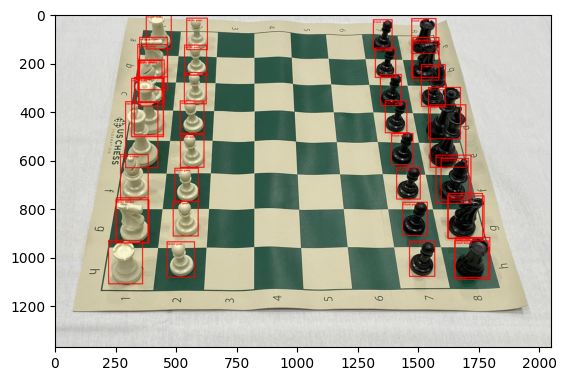

In [77]:
plt.imshow(to_pil_image(box.detach()))

---
### Zadanie 1

Zbadaj wpływ parametrów inferencji **głowic `RoIHeads`**, progu prawdopodobieństwa (`score_thresh`) i progu NMS (`nms_thresh`), na działanie modelu. Wykorzystaj funkcję `evaluate` aby zmierzyć zmianę jakości predykcji, ale przebadaj też efekty wizualnie, wyświetlając predykcje dla kilku obrazów ze zbioru walidacyjnego i kilku spoza zbioru (folder `wild`). _W finalnej wersji pozostaw tylko wybrane interesujące przykłady._

In [78]:
print(f'Score thresh: {model.roi_heads.score_thresh}')
print(f'NMS thresh: {model.roi_heads.nms_thresh}')

Score thresh: 0.05
NMS thresh: 0.5


In [126]:
# Obrazy
file_names = [
    'valid/3baf85c957b9d28a16c0b65cb2ef0d29_jpg.rf.ee68e051c8a61b8784b87686d828cf59.jpg',
    'valid/IMG_0293_JPG.rf.f29eab19f33f4c8ef04f9188d7ff1de7.jpg',
    'valid/e53bf8a0e692a4ccd5f1dc2bc19e7751_jpg.rf.181fa15089d35840f7c13edd8e22b1f5.jpg',
    'chesscom_fide.jpeg',
    'chesscom_uscf.jpeg',
    'shop.jpg'
]
img_paths = [ DATASET_ROOT + name for name in file_names]


In [99]:
def visualize_predictions(model, device, images_path_names, dataset, num_columns=3):
    model.eval()
    num_images = len(images_path_names)
    num_rows = (num_images + num_columns - 1) // num_columns 

    fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 5 * num_rows))
    axs = axs.flatten()

    for i, img_path in enumerate(images_path_names):
        img = read_image(img_path)
        batch = [preprocess(img).to(device)]

        with torch.no_grad():
            prediction = model(batch)[0]

        # Liczenie liczby wykrytych obiektów
        num_boxes = len(prediction['boxes'])

        # Rysowanie pudełek (bounding boxes)
        box_img = draw_bounding_boxes(
            img,
            boxes=prediction['boxes'],
            labels=[dataset.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4
        )

        # Wyświetlanie obrazu w subplots
        axs[i].imshow(to_pil_image(box_img.detach()))
        axs[i].set_title(f"Image {i+1}, Boxes: {num_boxes}")
        axs[i].axis("off")

    plt.tight_layout()
    plt.show()

## score_thresholds

Evaluating with score_thresh=0.001 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:02:33  model_time: 2.4602 (2.4602)  evaluator_time: 0.0030 (0.0030)  time: 2.6452  data: 0.1750  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 2.1748 (2.2041)  evaluator_time: 0.0020 (0.0024)  time: 2.2947  data: 0.1107  max mem: 5304
Test: Total time: 0:02:14 (2.3271 s / it)
Averaged stats: model_time: 2.1748 (2.2041)  evaluator_time: 0.0020 (0.0024)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.175
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.246
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.175
 Average 

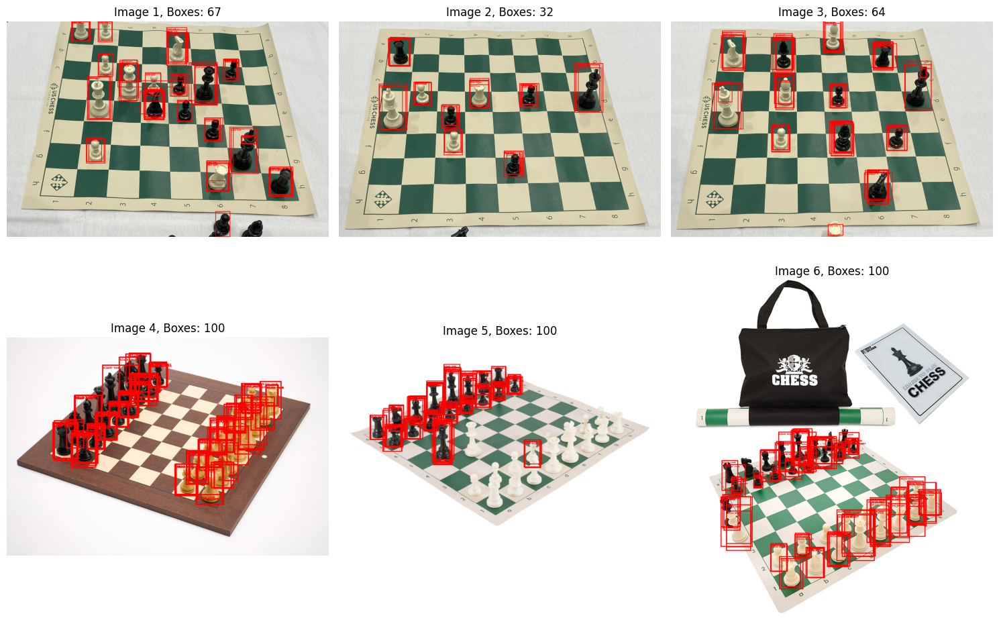

Evaluating with score_thresh=0.01 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:02:53  model_time: 2.7695 (2.7695)  evaluator_time: 0.0020 (0.0020)  time: 2.9915  data: 0.2130  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 2.1388 (2.3265)  evaluator_time: 0.0010 (0.0019)  time: 2.2606  data: 0.1097  max mem: 5304
Test: Total time: 0:02:22 (2.4538 s / it)
Averaged stats: model_time: 2.1388 (2.3265)  evaluator_time: 0.0010 (0.0019)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.173
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.250
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.217
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.173
 Average R

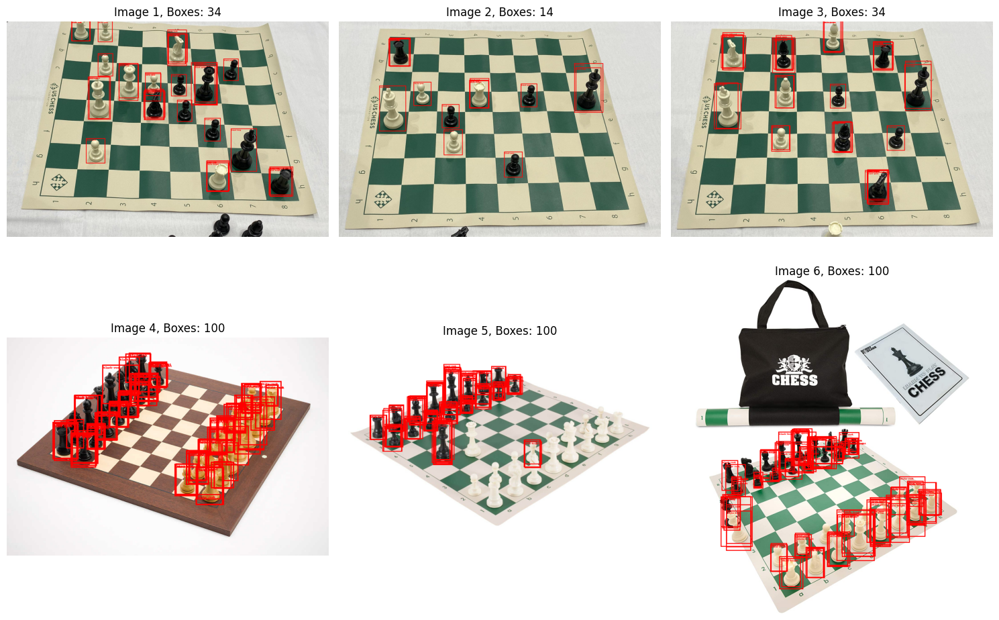

Evaluating with score_thresh=0.05 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:02:25  model_time: 2.3114 (2.3114)  evaluator_time: 0.0020 (0.0020)  time: 2.5114  data: 0.1920  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 2.1682 (2.3499)  evaluator_time: 0.0010 (0.0016)  time: 2.3993  data: 0.1137  max mem: 5304
Test: Total time: 0:02:23 (2.4762 s / it)
Averaged stats: model_time: 2.1682 (2.3499)  evaluator_time: 0.0010 (0.0016)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.175
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.236
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.209
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.175
 Average R

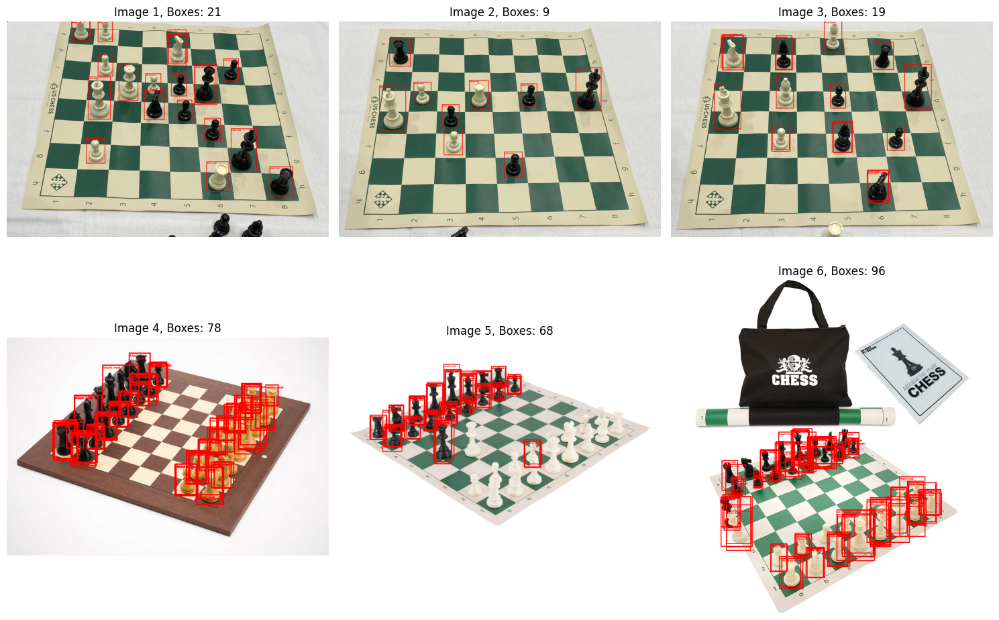

Evaluating with score_thresh=0.1 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:02:44  model_time: 2.6259 (2.6259)  evaluator_time: 0.0020 (0.0020)  time: 2.8411  data: 0.2053  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 2.6021 (2.5700)  evaluator_time: 0.0010 (0.0016)  time: 2.6744  data: 0.1123  max mem: 5304
Test: Total time: 0:02:36 (2.6957 s / it)
Averaged stats: model_time: 2.6021 (2.5700)  evaluator_time: 0.0010 (0.0016)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.352
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.256
 Average Re

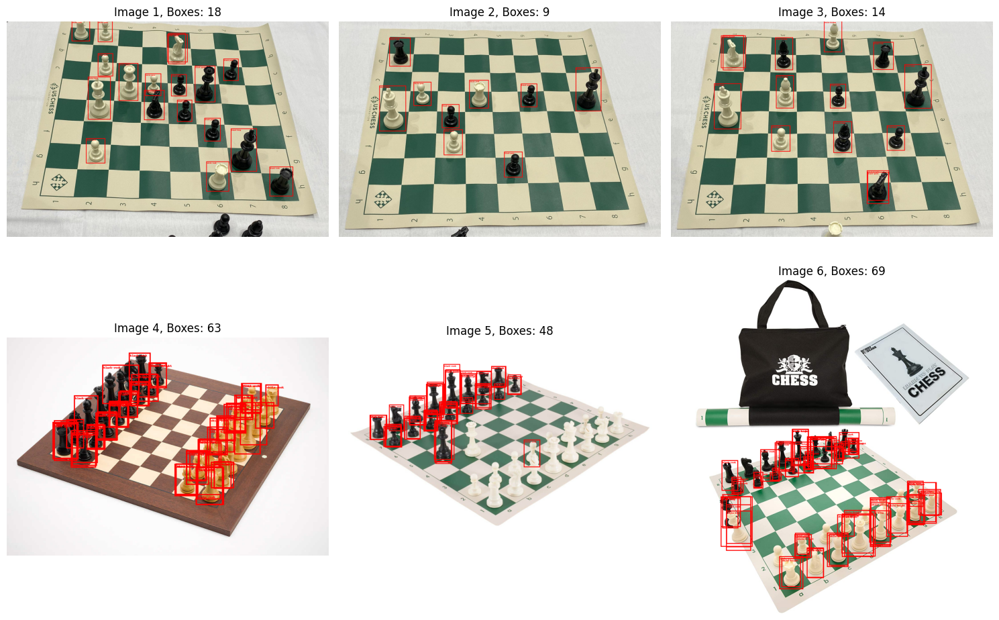

In [100]:
nms_thresh = 0.5
score_thresholds = [0.001, 0.01, 0.05, 0.1]

for score_thresh in score_thresholds:
        print(f"Evaluating with score_thresh={score_thresh} and nms_thresh={nms_thresh}")
        
        # Ustawiamy progi dla modelu
        model.roi_heads.score_thresh = score_thresh
        model.roi_heads.nms_thresh = nms_thresh
        
        # Ewaluacja modelu
        evaluate(model, val_loader, device=DEVICE)

        # Wizualizacja predykcji na obrazach
        visualize_predictions(model, DEVICE, img_paths, chess_val)

## nms_thresholds

Evaluating with score_thresh=0.05 and nms_thresh=0.3
Test:  [ 0/58]  eta: 0:02:13  model_time: 2.1196 (2.1196)  evaluator_time: 0.0030 (0.0030)  time: 2.3000  data: 0.1714  max mem: 5304
Test:  [57/58]  eta: 0:00:01  model_time: 1.4755 (1.4426)  evaluator_time: 0.0010 (0.0016)  time: 1.8196  data: 0.1115  max mem: 5304
Test: Total time: 0:01:30 (1.5615 s / it)
Averaged stats: model_time: 1.4755 (1.4426)  evaluator_time: 0.0010 (0.0016)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.259
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.356
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.259
 Average R

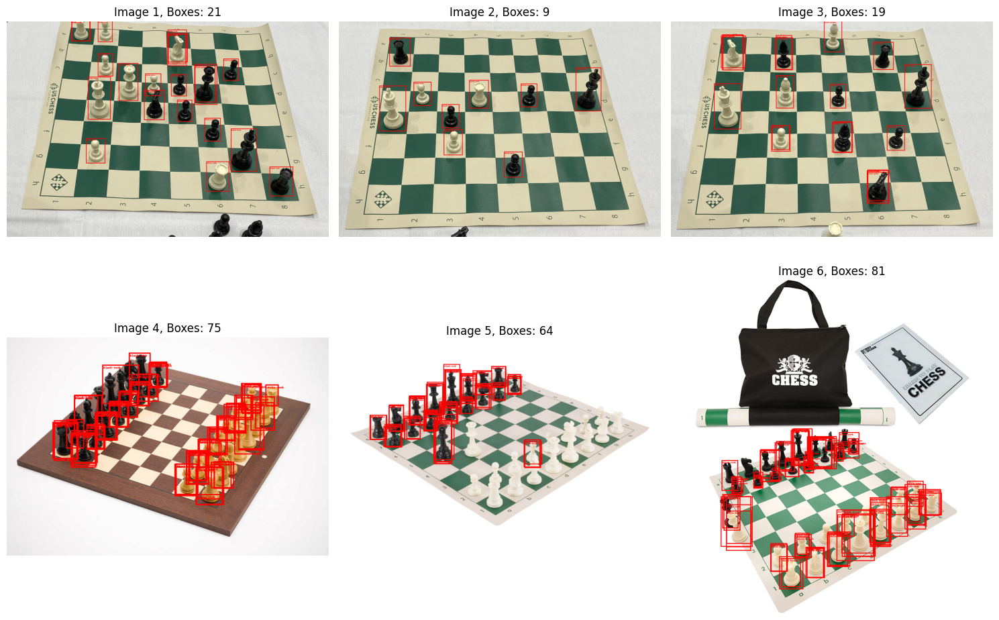

Evaluating with score_thresh=0.05 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:02:14  model_time: 2.1174 (2.1174)  evaluator_time: 0.0030 (0.0030)  time: 2.3134  data: 0.1850  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 2.1061 (1.9329)  evaluator_time: 0.0010 (0.0017)  time: 2.1168  data: 0.1143  max mem: 5304
Test: Total time: 0:01:59 (2.0621 s / it)
Averaged stats: model_time: 2.1061 (1.9329)  evaluator_time: 0.0010 (0.0017)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.224
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.224
 Average R

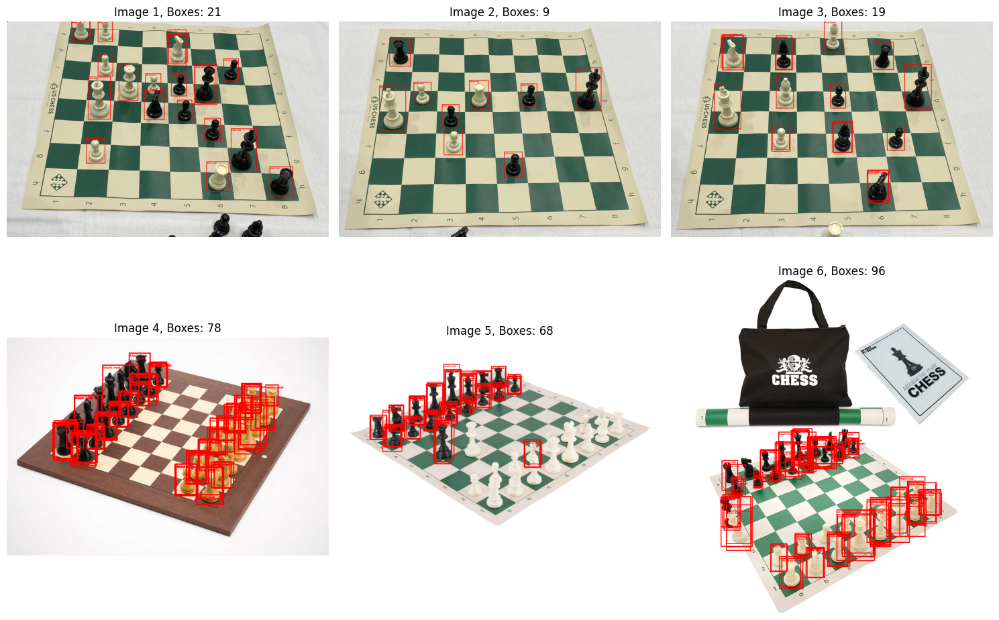

Evaluating with score_thresh=0.05 and nms_thresh=0.8
Test:  [ 0/58]  eta: 0:01:54  model_time: 1.7384 (1.7384)  evaluator_time: 0.0020 (0.0020)  time: 1.9801  data: 0.2327  max mem: 5304
Test:  [57/58]  eta: 0:00:01  model_time: 1.2634 (1.4823)  evaluator_time: 0.0010 (0.0016)  time: 1.6301  data: 0.1133  max mem: 5304
Test: Total time: 0:01:33 (1.6066 s / it)
Averaged stats: model_time: 1.2634 (1.4823)  evaluator_time: 0.0010 (0.0016)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.172
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.239
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.214
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.172
 Average R

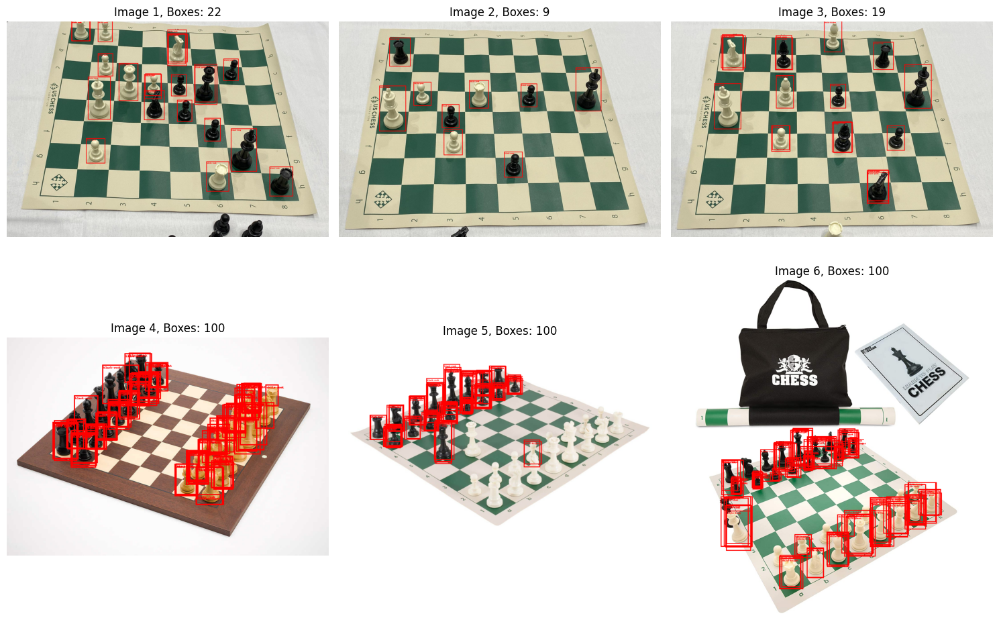

Evaluating with score_thresh=0.05 and nms_thresh=0.95
Test:  [ 0/58]  eta: 0:02:28  model_time: 2.2926 (2.2926)  evaluator_time: 0.0040 (0.0040)  time: 2.5536  data: 0.2480  max mem: 5304
Test:  [57/58]  eta: 0:00:02  model_time: 1.5760 (1.8679)  evaluator_time: 0.0020 (0.0030)  time: 1.7659  data: 0.1150  max mem: 5304
Test: Total time: 0:01:56 (2.0026 s / it)
Averaged stats: model_time: 1.5760 (1.8679)  evaluator_time: 0.0020 (0.0030)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.557
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.530
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.435
 Average 

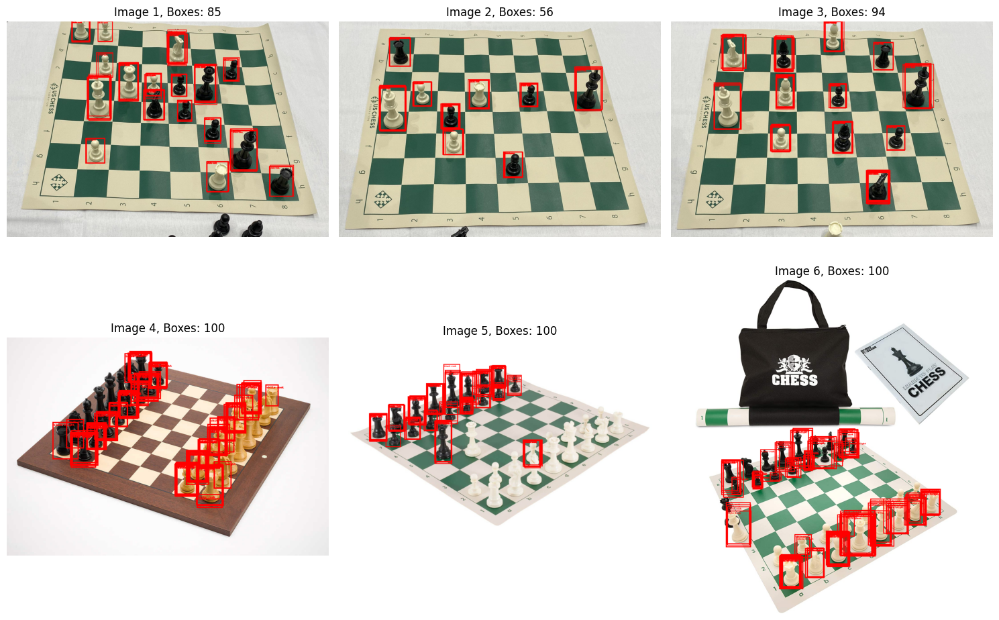

In [102]:
nms_thresholds = [0.3, 0.5, 0.8, 0.95]
score_thresh = 0.05

for nms_thresh in nms_thresholds:
        print(f"Evaluating with score_thresh={score_thresh} and nms_thresh={nms_thresh}")
        
        # Ustawiamy progi dla modelu
        model.roi_heads.score_thresh = score_thresh
        model.roi_heads.nms_thresh = nms_thresh
        
        # Ewaluacja modelu
        evaluate(model, val_loader, device=DEVICE)

        # Wizualizacja predykcji na obrazach
        visualize_predictions(model, DEVICE, img_paths, chess_val)

### Zadanie 2a

Zwizualizuj propozycje rejonów wygenerowane przez RPN i porównaj z ostateczną predykcją.

W tym celu konieczne będzie manualne wykonanie fragmentu metody `GeneralizedRCNN::forward` (patrz: [kod](https://github.com/pytorch/vision/blob/6279faa88a3fe7de49bf58284d31e3941b768522/torchvision/models/detection/generalized_rcnn.py#L46), link do wersji najnowszej na grudzień 2024).
Wszystkie fragmenty związane z uczeniem możesz rzecz jasna pominąć; chodzi o wyciągnięcie obiektu `proposals`.
Nie zapomnij o wykonaniu powrotnej transformacji! (Po co?)

Modele, takie jak Faster R-CNN, przetwarzają obrazy w zmienionych rozmiarach (np. przeskalowanych lub wypośrodkowanych). Bez transformacji powrotnej współrzędne wynikowych bounding boxów (prostokątów ograniczających) byłyby w odniesieniu do przetworzonego obrazu, a nie oryginalnego.


In [160]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.2

In [161]:
# transformacja propozycji RPN na oryginalny rozmiar obrazu
def resize_boxes(boxes, original_size, new_size):
    ratios = [new_size[0] / original_size[0], new_size[1] / original_size[1]]
    ratio_height, ratio_width = ratios
    scale_factors = torch.tensor([ratio_width, ratio_height, ratio_width, ratio_height], dtype=torch.float32)
    boxes = boxes * scale_factors.to(boxes.device)
    return boxes

def extract_proposals_and_predictions(model, images):
    model.eval()
    original_image_sizes = [img.shape[-2:] for img in images]

    images, _ = model.transform(images)

    # Ekstrakcja cech z backbone modelu
    features = model.backbone(images.tensors)
    if isinstance(features, torch.Tensor):
        features = {"0": features}
    
    proposals, _ = model.rpn(images, features, None)
    
    detections, _ = model.roi_heads(features, proposals, images.image_sizes, None)
    
    # Post-processing
    detections = model.transform.postprocess(detections, images.image_sizes, original_image_sizes)

    # Zastosowanie transformacji powrotnej
    proposals = [resize_boxes(proposal, im_size, orig_size) for proposal, im_size, orig_size in zip(proposals, images.image_sizes, original_image_sizes)]

    return proposals, detections


def visualize_proposals_and_predictions(images, proposals, detections, dataset):
    for img, proposal, detection in zip(images, proposals, detections):
        
        num_proposals = len(proposal)
        num_detections = len(detection['boxes'])

        proposal_img = draw_bounding_boxes(img.cpu(), boxes=proposal, colors='gray', width=1)

        detection_boxes = detection['boxes']
        detection_labels = [dataset.coco.cats[i.item()]['name'] for i in detection['labels']]

        detection_img = draw_bounding_boxes(proposal_img, boxes=detection_boxes, labels=detection_labels, colors='red', width=2)

        plt.figure(figsize=(12, 12))
        plt.imshow(F.to_pil_image(detection_img))
        plt.axis('off')
        plt.title(f"Proposals: {num_proposals}, Detections : {num_detections}")
        plt.show()

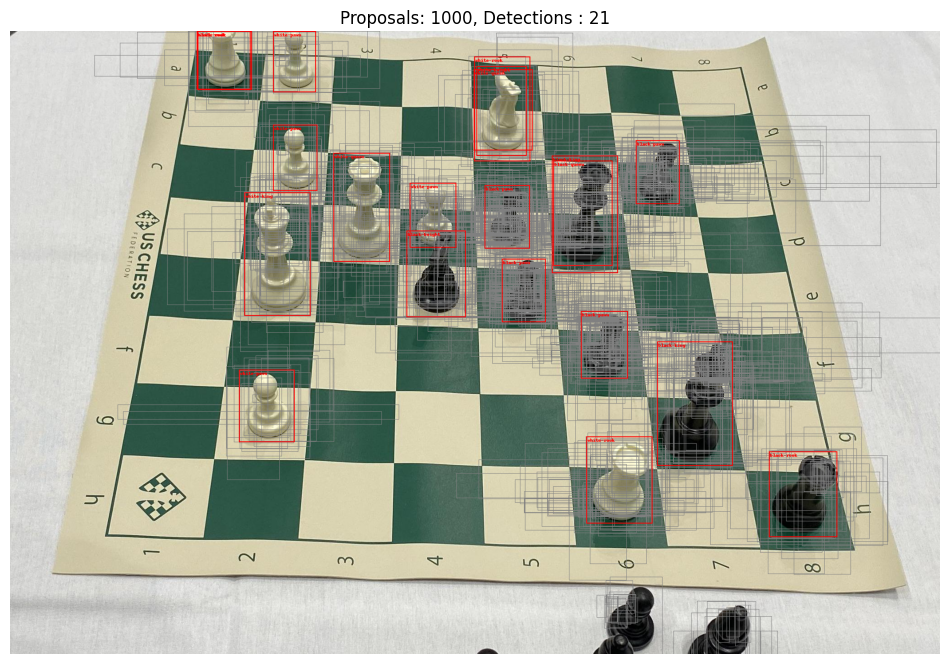

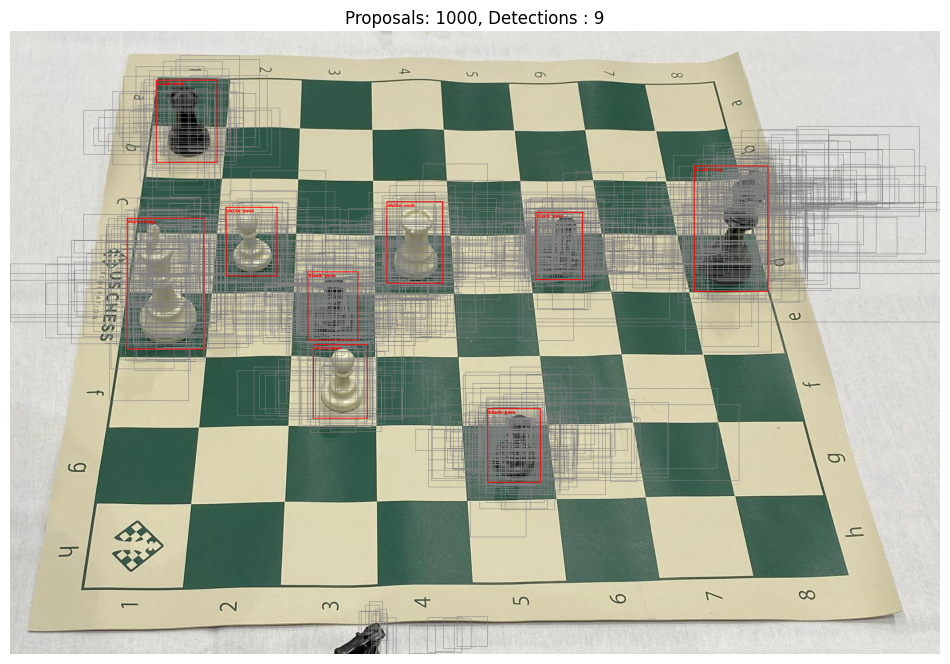

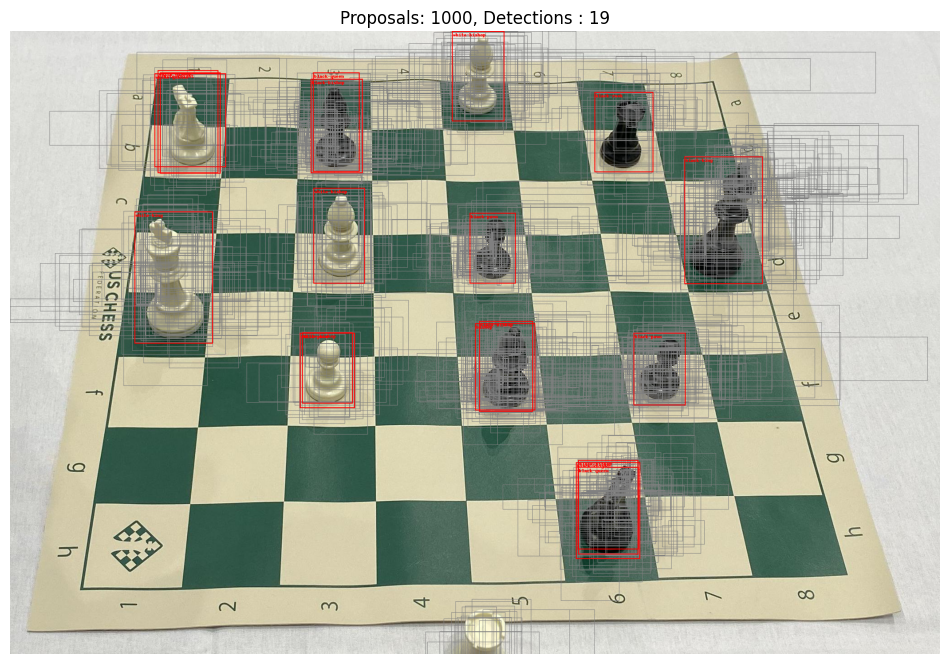

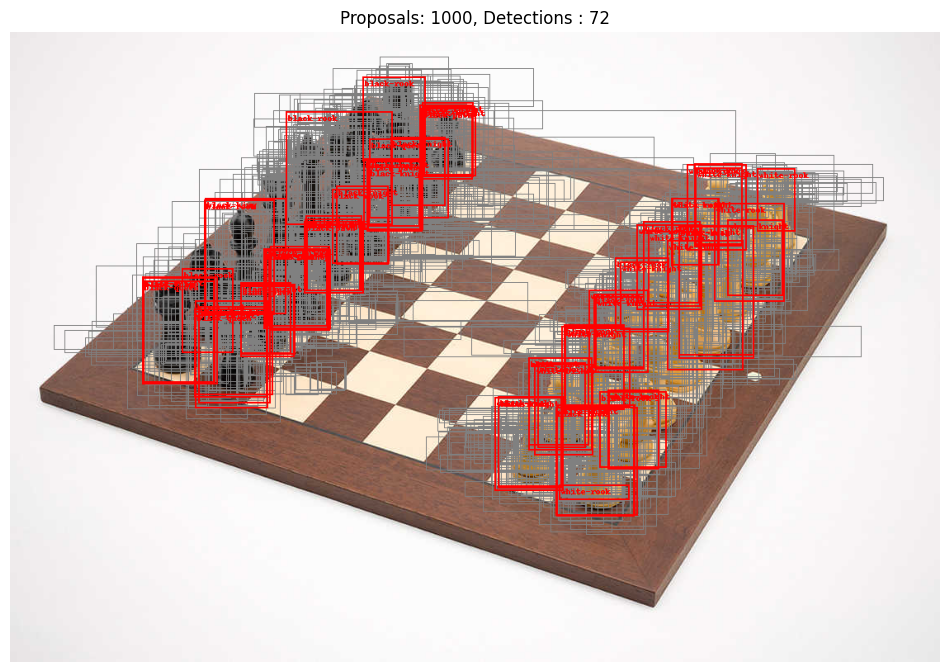

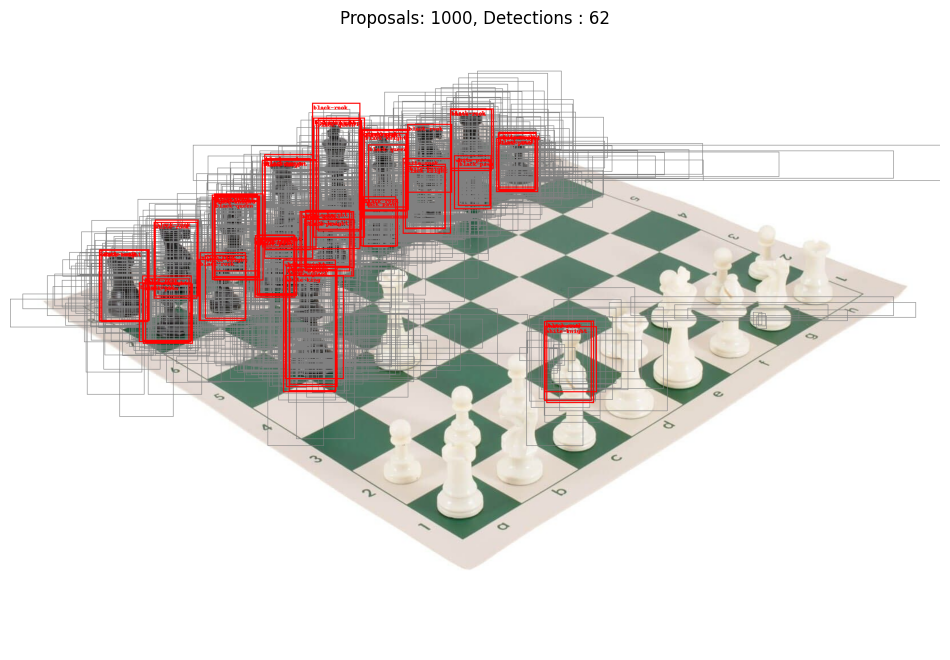

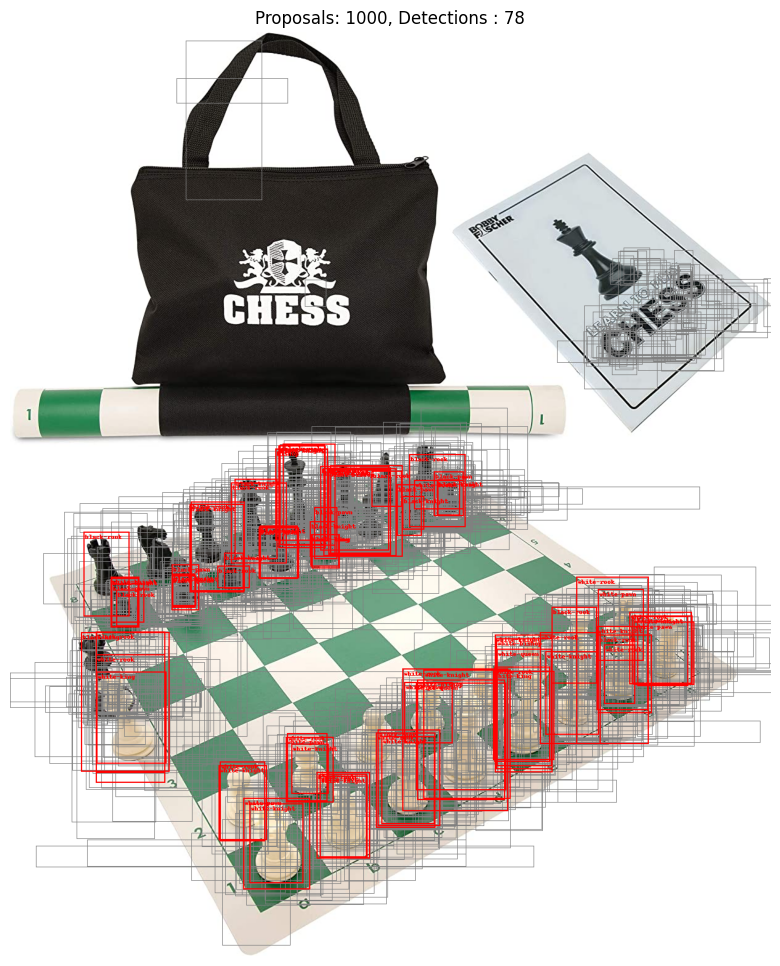

In [162]:
for img_path in img_paths:
    img = read_image(img_path)
    batch = [preprocess(img).to(DEVICE)]
    model.eval()

    with torch.no_grad():
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)

### Zadanie 2b

Zbadaj wpływ progu NMS _na etapie propozycji_ na jakość predykcji oraz czas ich uzyskania.
Jak w poprzednich zadaniach, postaraj się nie ograniczyć tylko do pokazania metryk, ale pokaż wizualizacje (propozycji i predykcji) dla **wybranych** przykładów.

In [176]:
model.rpn.nms_thresh = 0.7
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.5

Evaluating with RPN NMS threshold: 0.1
Test:  [ 0/58]  eta: 0:09:12  model_time: 9.3167 (9.3167)  evaluator_time: 0.0030 (0.0030)  time: 9.5308  data: 0.2030  max mem: 5541
Test:  [57/58]  eta: 0:00:04  model_time: 3.6284 (4.1619)  evaluator_time: 0.0010 (0.0017)  time: 3.9258  data: 0.1168  max mem: 5541
Test: Total time: 0:04:09 (4.2948 s / it)
Averaged stats: model_time: 3.6284 (4.1619)  evaluator_time: 0.0010 (0.0017)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.404
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.367
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.307
 Average Recall     (AR)

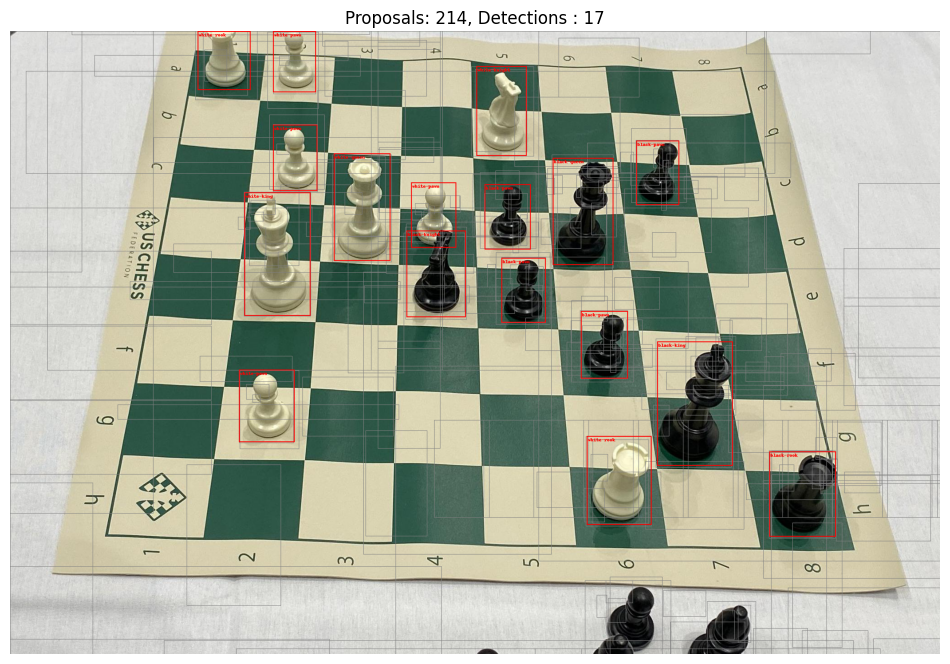

Evaluating with RPN NMS threshold: 0.4
Test:  [ 0/58]  eta: 0:12:50  model_time: 13.0896 (13.0896)  evaluator_time: 0.0030 (0.0030)  time: 13.2856  data: 0.1840  max mem: 5541
Test:  [57/58]  eta: 0:00:04  model_time: 2.0379 (3.9391)  evaluator_time: 0.0010 (0.0017)  time: 2.8745  data: 0.1086  max mem: 5541
Test: Total time: 0:03:55 (4.0683 s / it)
Averaged stats: model_time: 2.0379 (3.9391)  evaluator_time: 0.0010 (0.0017)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.386
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.510
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.386
 Average Recall     (

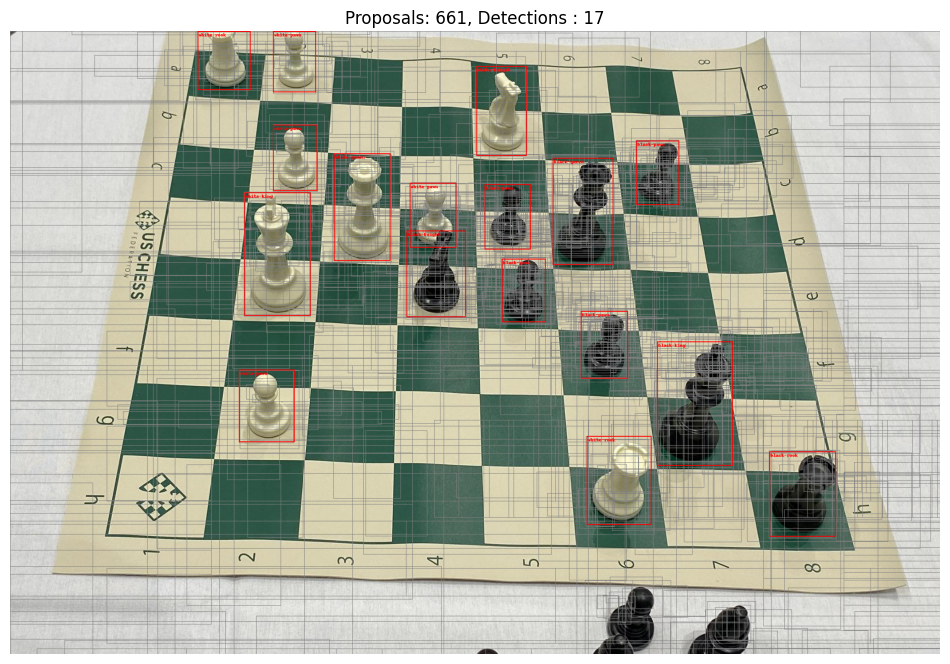

Evaluating with RPN NMS threshold: 0.7
Test:  [ 0/58]  eta: 0:02:08  model_time: 2.0191 (2.0191)  evaluator_time: 0.0020 (0.0020)  time: 2.2081  data: 0.1780  max mem: 5541
Test:  [57/58]  eta: 0:00:02  model_time: 2.1242 (2.2043)  evaluator_time: 0.0010 (0.0017)  time: 2.2503  data: 0.1123  max mem: 5541
Test: Total time: 0:02:15 (2.3318 s / it)
Averaged stats: model_time: 2.1242 (2.2043)  evaluator_time: 0.0010 (0.0017)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.216
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.189
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.157
 Average Recall     (AR)

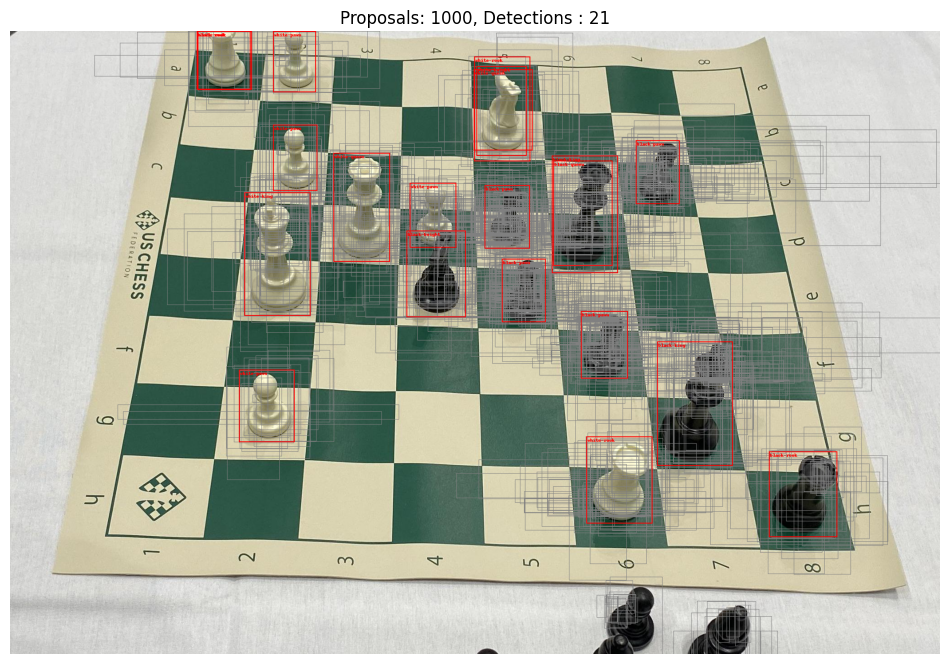

Evaluating with RPN NMS threshold: 0.9
Test:  [ 0/58]  eta: 0:02:26  model_time: 2.3468 (2.3468)  evaluator_time: 0.0020 (0.0020)  time: 2.5308  data: 0.1770  max mem: 5541
Test:  [57/58]  eta: 0:00:02  model_time: 2.0080 (2.0636)  evaluator_time: 0.0010 (0.0016)  time: 2.1285  data: 0.1068  max mem: 5541
Test: Total time: 0:02:06 (2.1837 s / it)
Averaged stats: model_time: 2.0080 (2.0636)  evaluator_time: 0.0010 (0.0016)
Accumulating evaluation results...
DONE (t=0.03s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.231
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.231
 Average Recall     (AR)

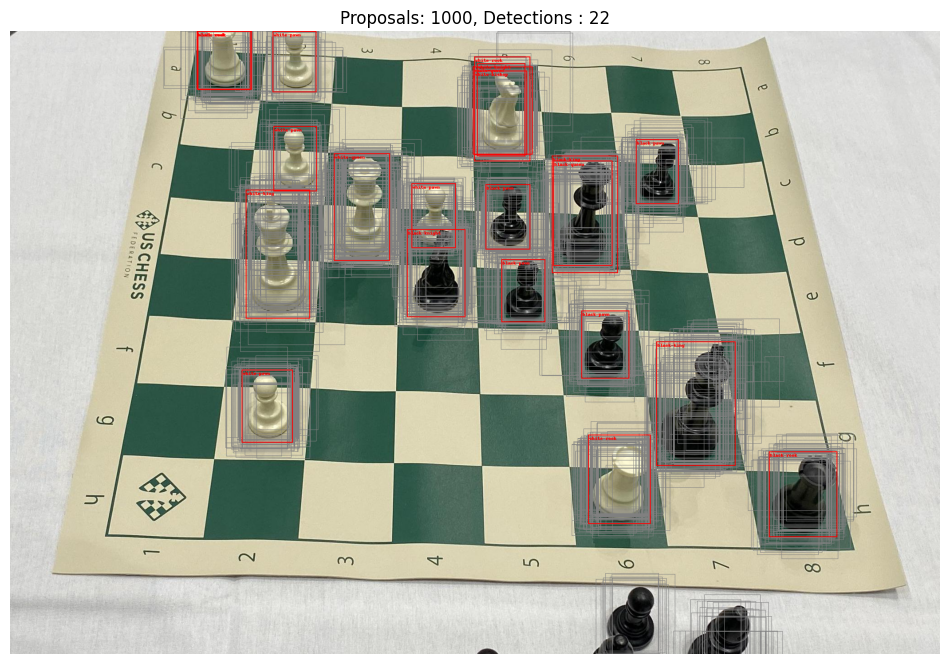

In [177]:
nms_thresholds = [0.1, 0.4, 0.7, 0.9]

for nms_thresh in nms_thresholds:
    print(f'Evaluating with RPN NMS threshold: {nms_thresh}')
    model.rpn.nms_thresh = nms_thresh
    evaluate(model, val_loader, device=DEVICE)

    # Visualize for a selected image
    img = read_image(img_paths[0])
    batch = [preprocess(img).to(DEVICE)]

    with torch.no_grad():
        start_time = time.time()
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        end_time = time.time()
        finall_time = end_time - start_time
        print(f'Time for proposals and predicions extractions: {finall_time}')
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)